IMPORT

In [4]:
# import pytorch and use fasterRCNN
import cv2
import time
import random
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
import torch
import torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.ops.boxes import nms
import os


In [2]:
# the path and some values
DEVICE = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

NUM_EPOCHS = 10

# Loading Data

In [9]:
from StarfishDataSet import BASE_DIR

df = pd.read_csv("D:/79381/Downloads/Diplom_Work/train-validation-split/train-0.1.csv")

# Turn annotations from strings into lists of dictionaries
df['annotations'] = df['annotations'].apply(eval)

# Create the image path for the row
df['image_path'] = "video_" + df['video_id'].astype(str) + "/" + df['video_frame'].astype(str) + ".jpg"

df.head()

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,n_annotations,has_annotations,image_path,subsequence_id,is_train
0,0,40258,0,0,0-0,[],0,False,video_0/0.jpg,1,True
1,0,40258,1,1,0-1,[],0,False,video_0/1.jpg,1,True
2,0,40258,2,2,0-2,[],0,False,video_0/2.jpg,1,True
3,0,40258,3,3,0-3,[],0,False,video_0/3.jpg,1,True
4,0,40258,4,4,0-4,[],0,False,video_0/4.jpg,1,True


In [10]:
df_train, df_val = df[df['is_train']], df[~df['is_train']]

In [11]:
# Turn annotations from strings into lists of dictionaries
#delete the annotations which are empty
df_train = df_train[df_train.annotations.str.len() > 0 ].reset_index(drop=True)
df_val = df_val[df_val.annotations.str.len() > 0 ].reset_index(drop=True)

In [27]:
df_train.shape[0], df_val.shape[0]

(4396, 523)

# Dataset

In [28]:
# here we experiment image augmentation using simple transformations
# 50% probability of horizontal flip and 50% probability of vertical flip
# we resize all pictures as 720*1280
def get_train_transform():
    return A.Compose([
        A.Flip(0.5),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.Resize(height=720, width=1280, p=1.0),
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

def get_valid_transform():
    return A.Compose([
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

In [29]:
from StarfishDataSet import StarfishDataset

ds_train = StarfishDataset(df_train, get_train_transform())
ds_val = StarfishDataset(df_val, get_valid_transform())

# Check the sample

In [31]:
image, targets = ds_train[2200]

error: OpenCV(4.7.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


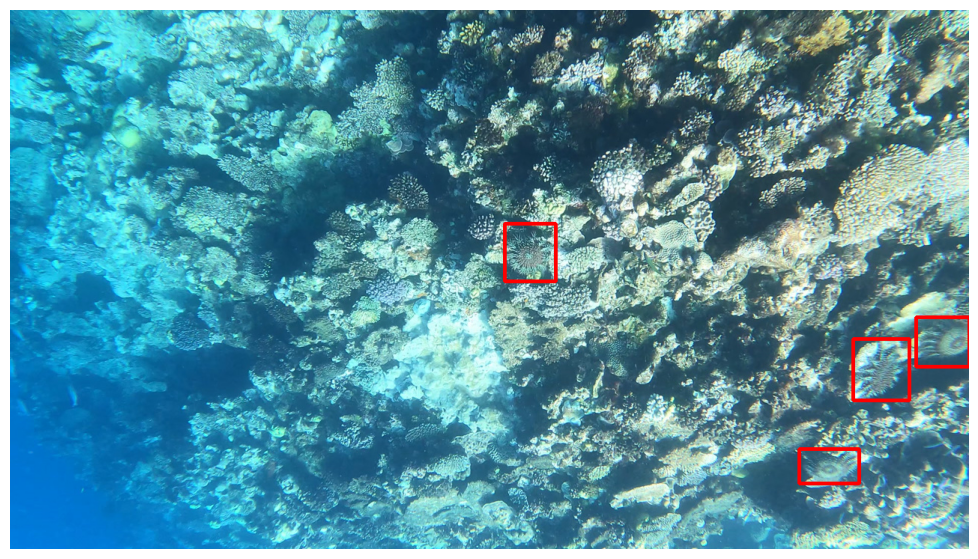

In [36]:
# In image,show the starfish in the boxes
boxes = targets['boxes'].cpu().numpy().astype(np.int32)
img = image.permute(1,2,0).cpu().numpy()#to put the channels as the last dimension
fig, ax = plt.subplots(1, 1, figsize=(15, 7))

for box in boxes:
    cv2.rectangle(img,
                  (box[0], box[1]),
                  (box[2], box[3]),
                  (220, 0, 0), 3)

ax.set_axis_off()
ax.imshow(img);

# Create Model and load data to it

In [8]:
from collate import collate_fn

# Create PyTorch DataLoader
#load the data for the model

#Due to the train speed, we adjust batch_size=8 and num_worker=2
dl_train = DataLoader(ds_train, batch_size=8, shuffle=False, num_workers=2, collate_fn=collate_fn)
dl_val = DataLoader(ds_val, batch_size=8, shuffle=False, num_workers=2, collate_fn=collate_fn)

In [9]:
def get_model():
    # load a resnet50 model and pre-train on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights='DEFAULT')
    # 1 class (starfish) + background
    num_classes = 2
    # размер входа для детекторной части
    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    #заменяем последние слои детекции с учётом количества наших классов и размера выхода backbone
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    model.to(DEVICE)
    return model

model = get_model()

In [ ]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.0015, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
#lr_scheduler = None

n_batches, n_batches_val = len(dl_train), len(dl_val)
validation_losses = []


for epoch in range(NUM_EPOCHS):
    time_start = time.time()
    loss_accum = 0
    
    for batch_idx, (images, targets) in enumerate(dl_train, 1):
        
        images = list(image.float().to(DEVICE) for image in images)
        targets = [{k: v.to(torch.float32).to(DEVICE) if "box" in k else v.to(DEVICE) for k, v in t.items()} for t in targets]

        # Predict
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()

        loss_accum += loss_value

        # Back-prop
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

    
    # update the learning rate
    if lr_scheduler is not None:
        lr_scheduler.step()

    # Validation 
    val_loss_accum = 0
        
    with torch.no_grad():
        for batch_idx, (images, targets) in enumerate(dl_val, 1):
            images = list(image.float().to(DEVICE) for image in images)
            targets = [{k: v.to(torch.float32).to(DEVICE) if "box" in k else v.to(DEVICE) for k, v in t.items()} for t in targets]
            
            val_loss_dict = model(images, targets)
            val_batch_loss = sum(loss for loss in val_loss_dict.values())
            val_loss_accum += val_batch_loss.item()
    
    # Logging
    val_loss = val_loss_accum / n_batches_val
    train_loss = loss_accum / n_batches
    validation_losses.append(val_loss)
    
    # Save model
    chk_name = f'fasterrcnn_resnet50_fpn-e{epoch}.bin'
    torch.save(model.state_dict(), chk_name)
    
    
    elapsed = time.time() - time_start
    
    print(f"[Epoch {epoch+1:2d} / {NUM_EPOCHS:2d}] Train loss: {train_loss:.3f}. Val loss: {val_loss:.3f} --> {chk_name}  [{elapsed:.0f} secs]")   

In [1]:
def show_pictures(path = '', a = 14, b = 6):
    model = get_model()
    if (path != ''):
        model.load_state_dict(torch.load(path, map_location=torch.device('cpu')))
    model.eval()

    for batch_idx, (images, targets) in enumerate(dl_val, 1):

        if batch_idx % 10 != 0:
            continue
        print(f'Batch {batch_idx}')

    #images, targets = next(iter(dl_val))
        images = list(img.to('cpu') for img in images)
        targets = [{k: v.to('cpu') for k, v in t.items()} for t in targets]

        outputs = model(images)
        outputs = [{k: v.detach().cpu().numpy() for k, v in t.items()} for t in outputs]

        i = 0
        for img in images:
            i+=1
            if i != 1:
                continue
            boxes = targets[i]['boxes'].cpu().numpy().astype(np.int32)
            sample = images[i].permute(1,2,0).cpu().numpy()

            fig, ax = plt.subplots(1, 1, figsize=(a, b))

        # Red for ground truth
            for box in boxes:
                cv2.rectangle(sample,
                  (int(box[0]), int(box[1])),
                  (int(box[2]), int(box[3])),
                  (220, 0, 0), 3)


        # Green for predictions
            for box in outputs[i]['boxes'][:5]:
                cv2.rectangle(sample,
                   (int(box[0]), int(box[1])),
                   (int(box[2]), int(box[3])),
                   (0, 220, 0), 3)

            ax.set_axis_off()
            ax.imshow(sample);
    #break

ModuleNotFoundError: No module named 'show_pictures_func'

Batch 10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 40


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 60


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 70


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 90


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Batch 120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


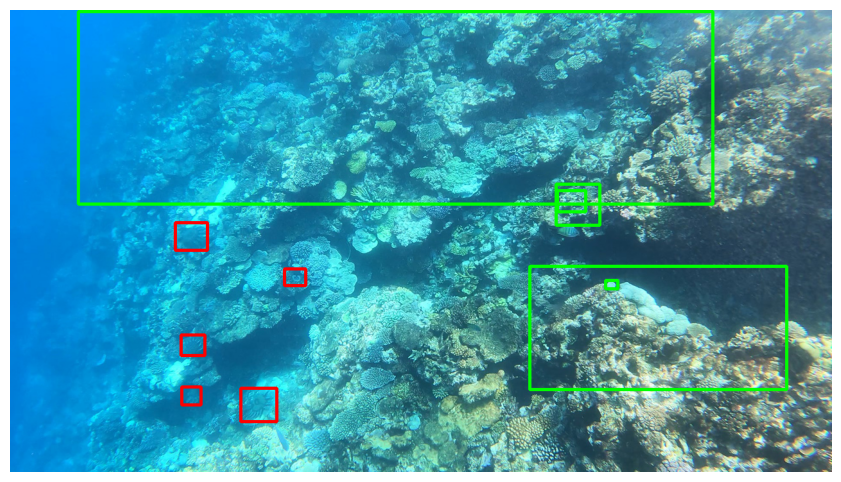

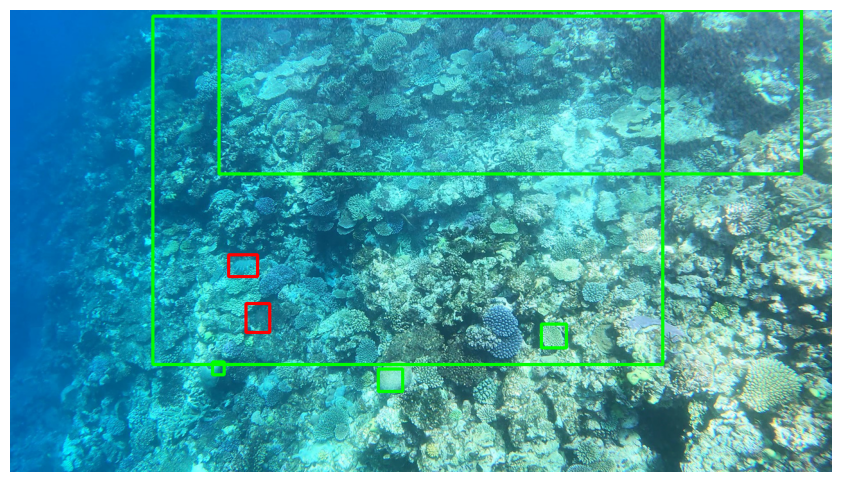

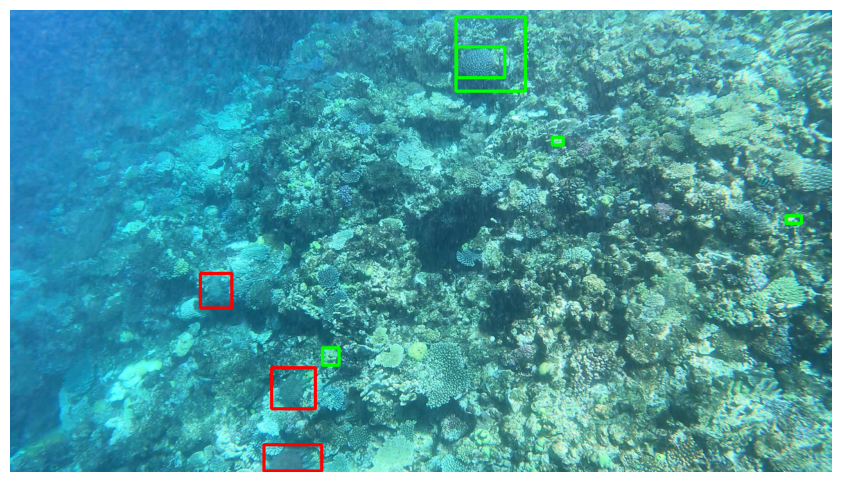

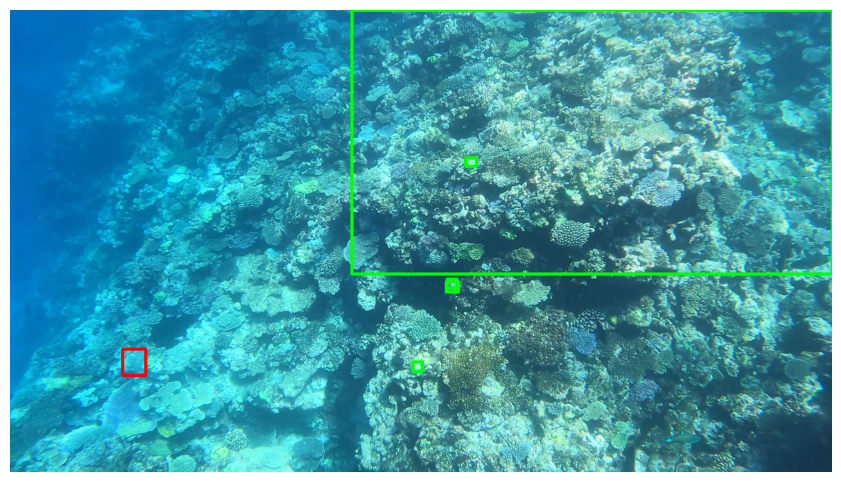

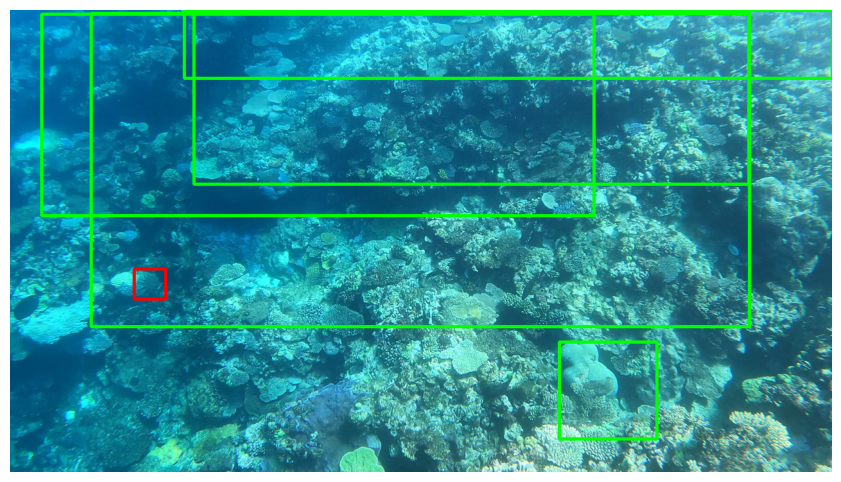

...

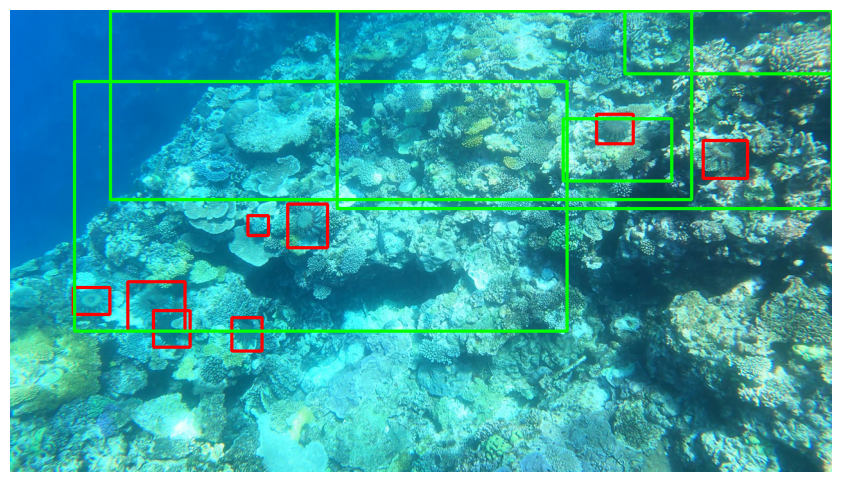

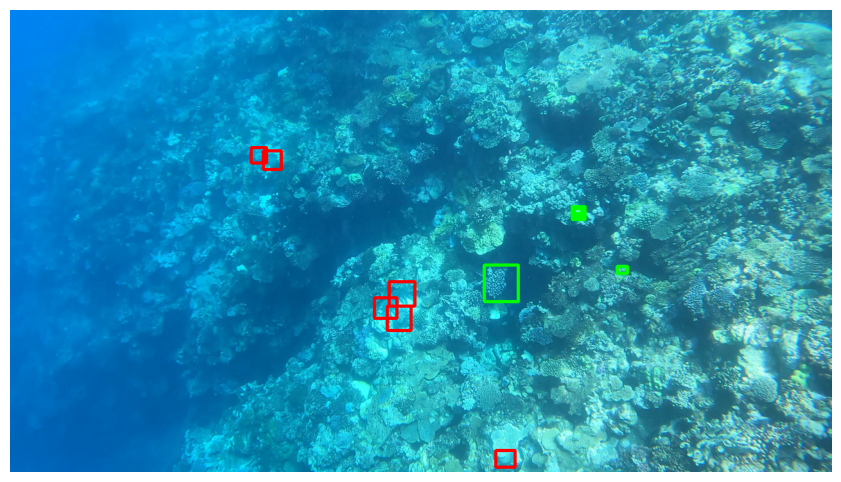

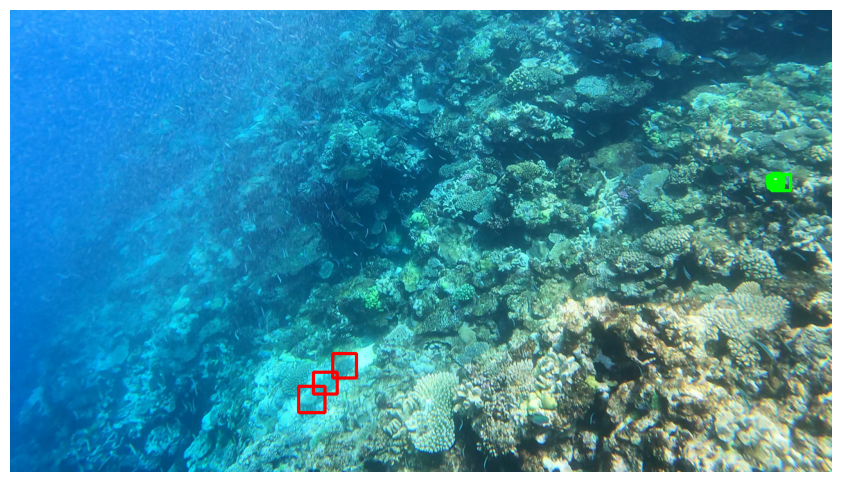

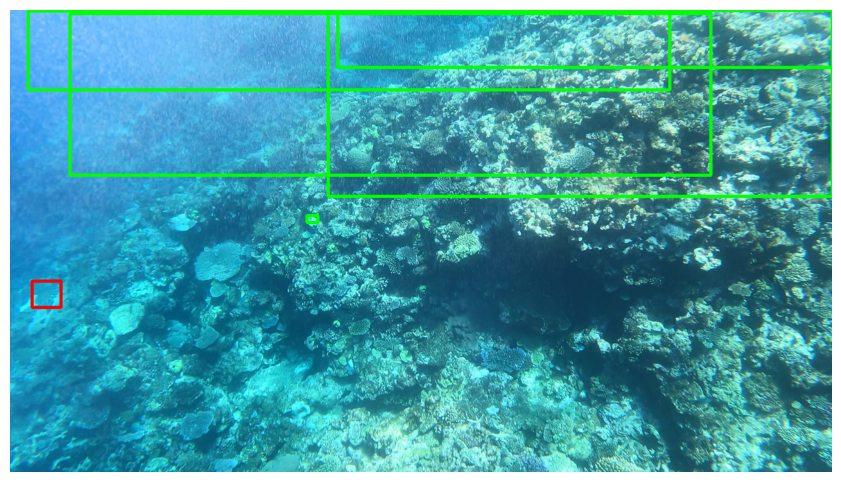

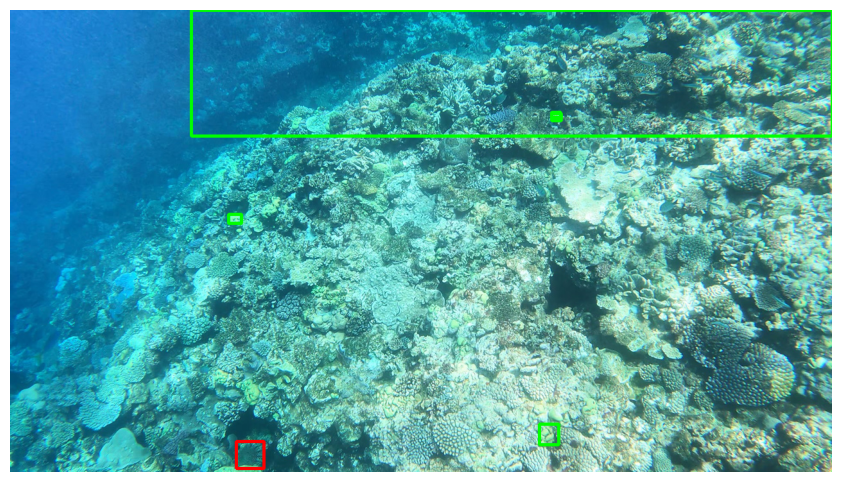

In [13]:
show_pictures()

In [28]:
PATH_7 = 'D:/79381/Downloads/fasterrcnn_resnet50_fpn-e6.pt'
PATH_3 = 'D:/79381/Downloads/fasterrcnn_resnet50_fpn-e2.pt'

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

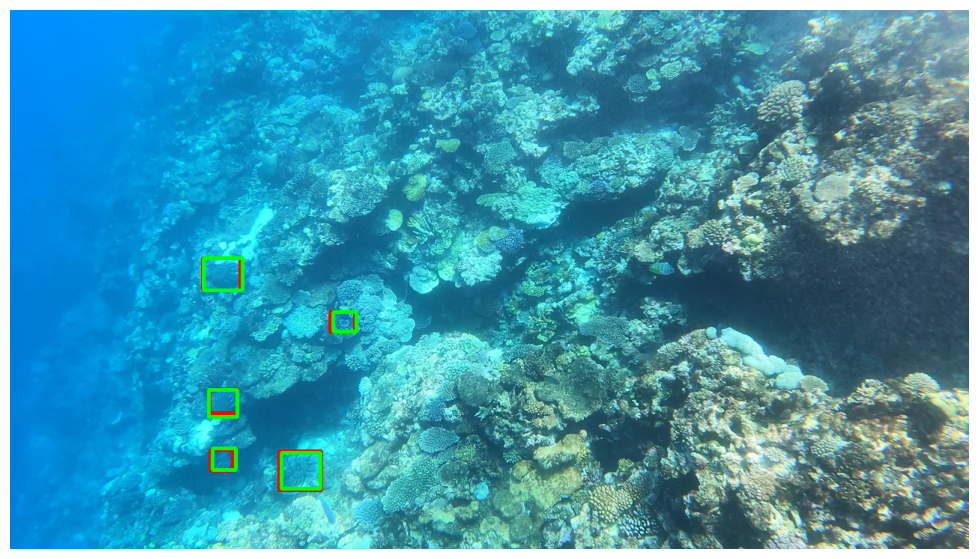

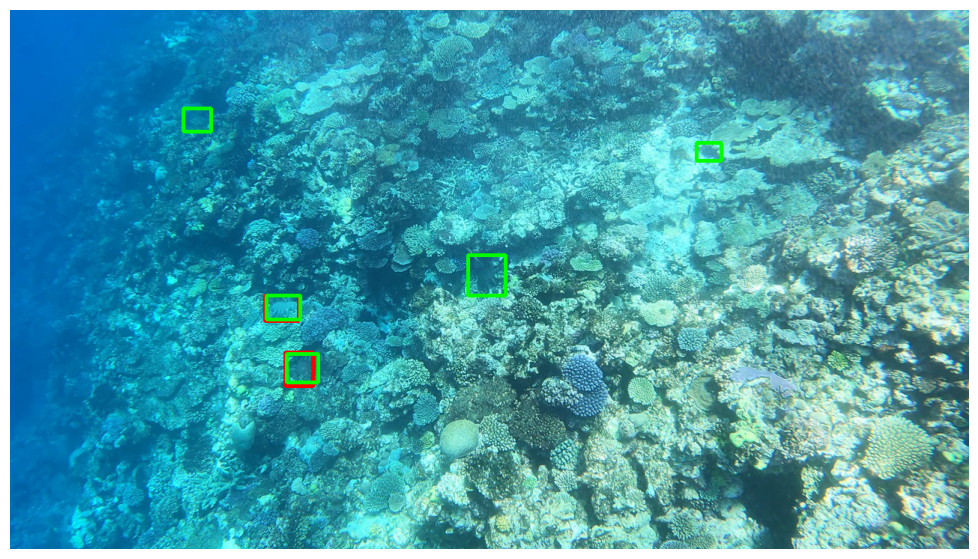

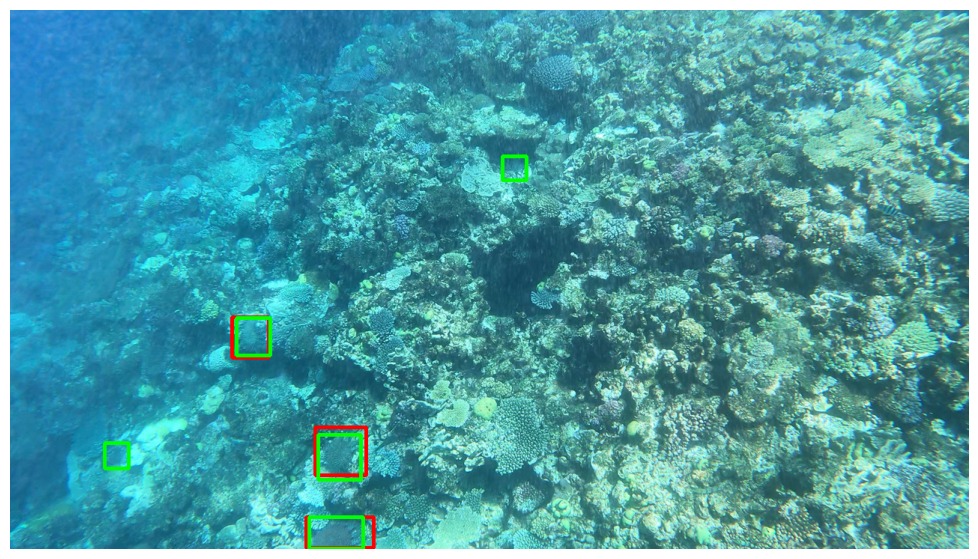

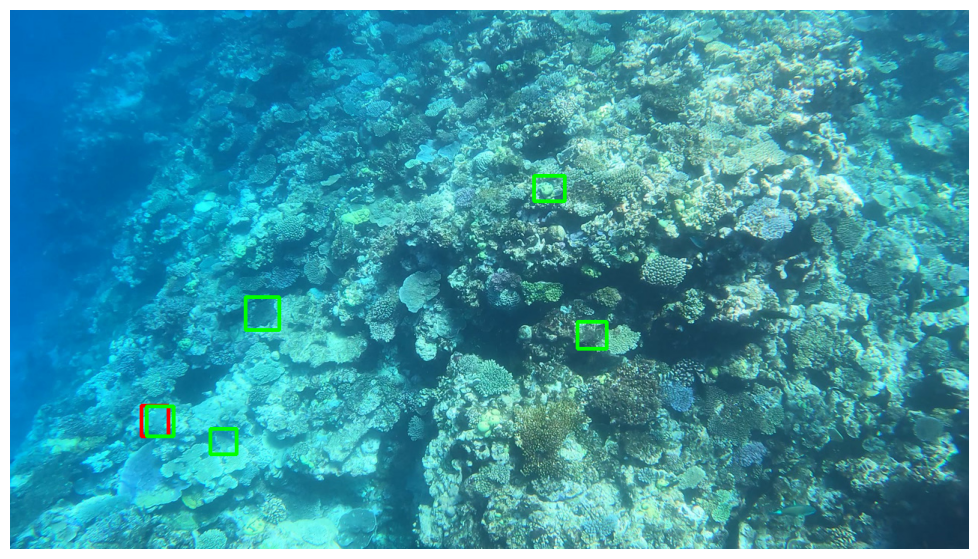

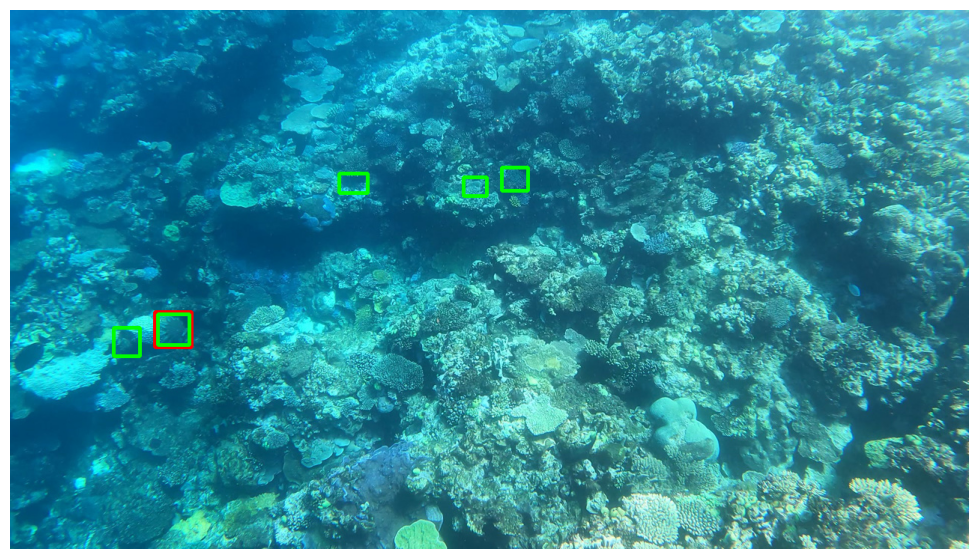

...

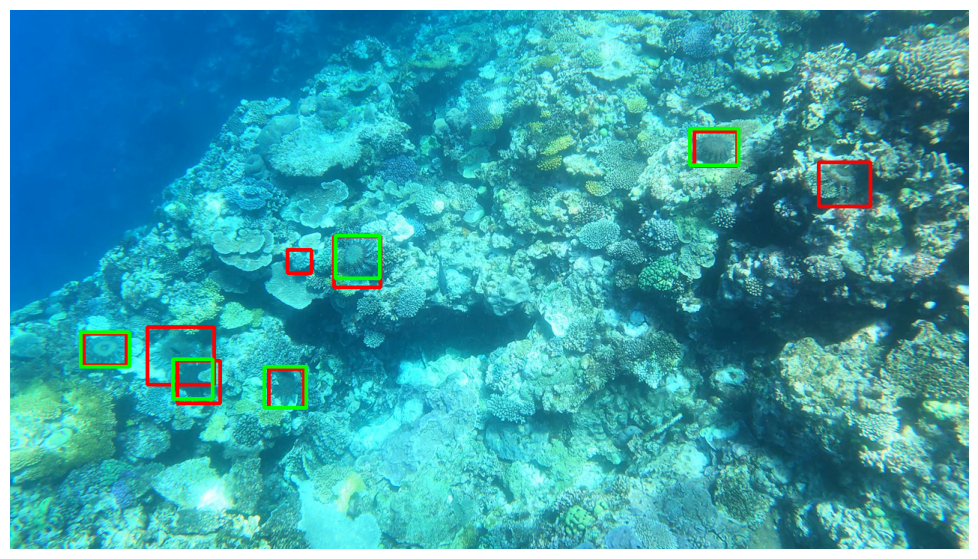

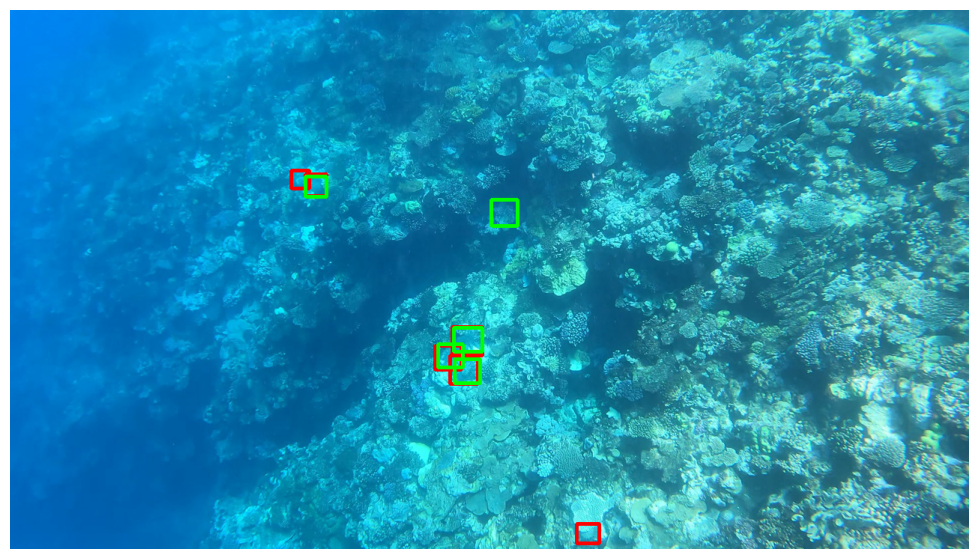

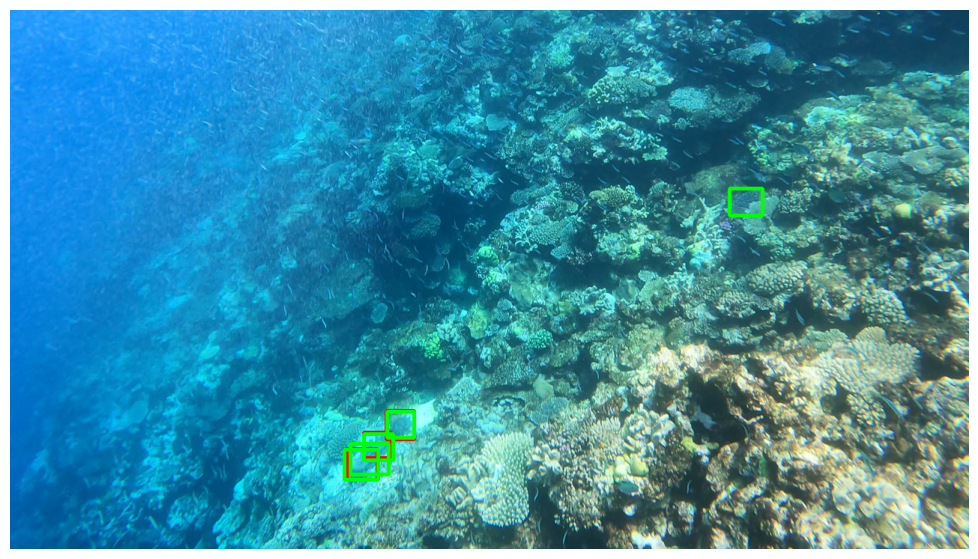

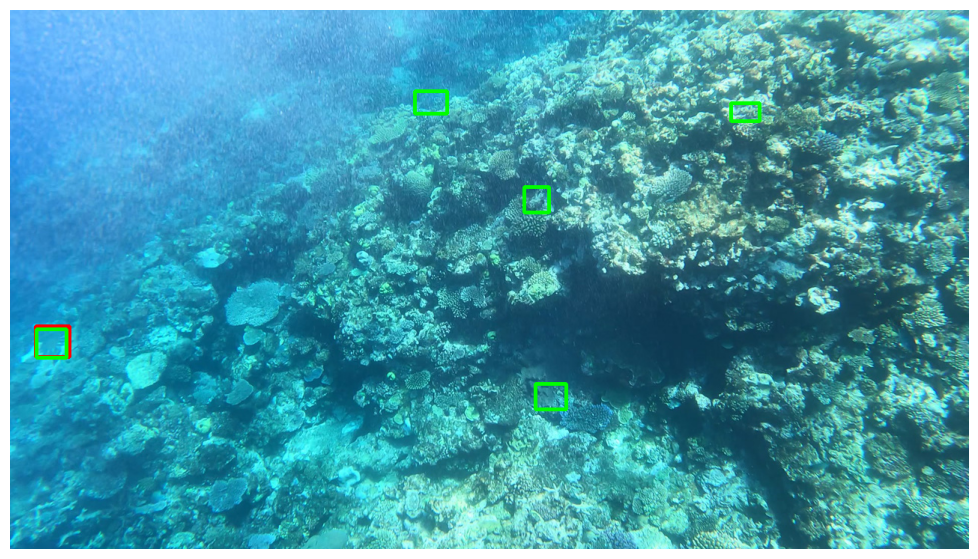

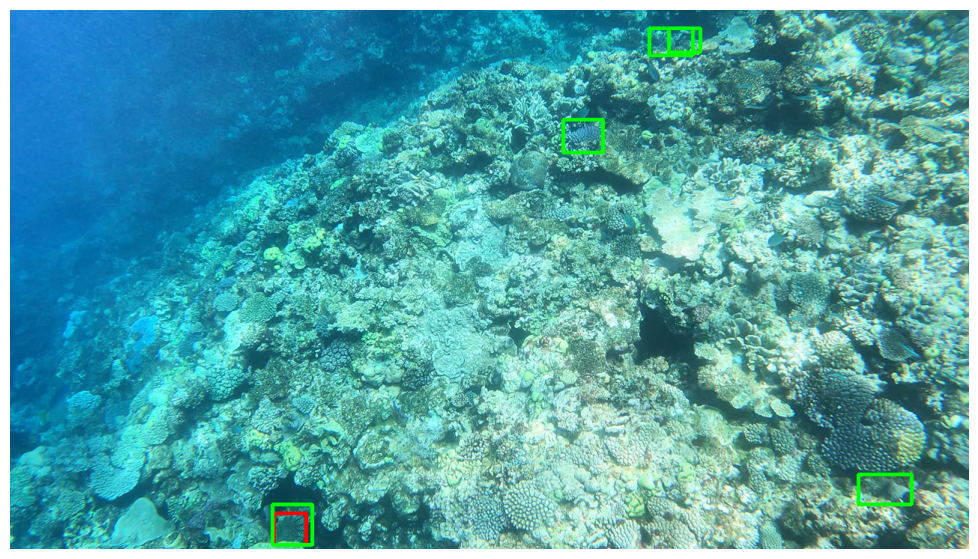

In [49]:
show_pictures(PATH_3)

In [ ]:
show_pictures(PATH_7)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

In [ ]:
show_pictures('D:/79381/Downloads/fasterrcnn_resnet50_fpn-e1.pt')

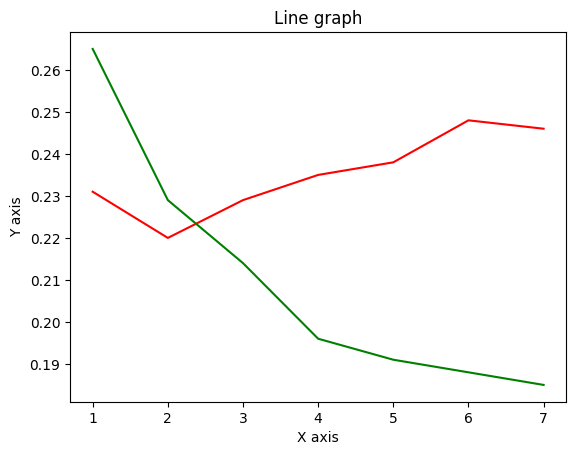

In [39]:
validation_losses = [0.231, 0.220, 0.229, 0.235, 0.238, 0.248, 0.246]
train_losses = [0.265, 0.229, 0.214, 0.196, 0.191, 0.188, 0.185]

# data to be plotted
y = np.arange(1,8)

# plotting
plt.title("Line graph")
plt.xlabel("X axis")
plt.ylabel("Y axis")
plt.plot(y, validation_losses, color ="red")
plt.plot(y, train_losses, color ="green")
plt.show()

In [43]:
fold = pd.read_csv('D:/79381/Downloads/train-10folds.csv')

In [44]:
fold

,video_id,sequence,video_frame,sequence_frame,image_id,annotations,n_annotations,has_annotations,image_path,subsequence_id,fold
0,0,40258,0,0,0-0,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,1,5
1,0,40258,1,1,0-1,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,1,5
2,0,40258,2,2,0-2,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,1,5
3,0,40258,3,3,0-3,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,1,5
4,0,40258,4,4,0-4,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,1,5
...,...,...,...,...,...,...,...,...,...,...,...
23496,2,29859,10755,2983,2-10755,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,137,7
23497,2,29859,10756,2984,2-10756,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,137,7
23498,2,29859,10757,2985,2-10757,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,137,7
23499,2,29859,10758,2986,2-10758,[],0,False,../input/tensorflow-great-barrier-reef/train_i...,137,7
